## Style embedding

We use the style embedding method proposed by [Gatys et al.](https://arxiv.org/abs/1508.06576) to transfer the style of a painting to a photograph. The method is based on the idea that the style of a painting can be represented by the correlations between the different filter responses of a CNN which are called the Gram matrices. The style of a painting is then transferred to a photograph by matching the correlations between the filter responses of the photograph and the painting.

For this we have modified the VGG19 network to capture the gram matrices from 5 layers of the network. The layers are `relu1_1`, `relu2_1`, `relu3_1`, `relu4_1` and `relu5_1`. 

![Schema](img/schema.png)

### UMAP



The gram matrices, which contain many features for every layer, are embedded to a 2D space using UMAP. This results in 5 vectors of length 2 for every painting. The vectors are then concatenated to a single vector of length 10.   

In [75]:
from PIL import Image
from pathlib import Path
import cv2

import matplotlib.pyplot as plt
from matplotlib.offsetbox import (AnnotationBbox, OffsetImage)
import numpy as np

from sklearn.neighbors import KDTree

In [76]:
def draw_umap_with_labels(umap_embeddings, labels, title=''):
    plt.figure(figsize=(8, 8))
    plt.scatter(umap_embeddings[:, 0], umap_embeddings[:, 1], c=labels, s=7, cmap='Spectral',)
    plt.title(title, fontsize=14)
    plt.show()

def draw_with_pictures(umap_embeddings, labels, pictures, title=''):
    fig, ax = plt.subplots(figsize=(8, 8))
    
    plt.scatter(umap_embeddings[:, 0], umap_embeddings[:, 1], c=labels, s=10, cmap='Spectral')
    for position, filename in zip(umap_embeddings, pictures):
        im = plt.imread(filename, format="jpg")
        im_transparent = np.dstack((im, 192 * np.ones((im.shape[0], im.shape[1], 1), dtype=np.uint8)))
        resized_image = cv2.resize(im_transparent, (100, 100), interpolation = cv2.INTER_CUBIC)

        imagebox = OffsetImage(resized_image, zoom=0.75)
        imagebox.image.axes = ax
        sb = AnnotationBbox(imagebox, (position[0], position[1]), bboxprops=dict(boxstyle="sawtooth", alpha=0.5))
        ax.add_artist(sb)

    ax.set_xlim(min(umap_embeddings[:,0])*0.8, max(umap_embeddings[:,0])*1.2)
    ax.set_ylim(min(umap_embeddings[:,1])*0.8, max(umap_embeddings[:,1])*1.2)
    plt.title(title, fontsize=14)
    plt.show()

def plot_images(images, labels, nrows, ncols, step=1):
    """Plot nrows x ncols images from images and set labels as titles."""
    figsize = [8, 8]
    fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=figsize)
    for i, ax in enumerate(axes.flat):
        idx = i * step
        if images[i].shape[-1] == 1:
            ax.imshow(images[i].reshape(images[idx].shape[0], images[idx].shape[1]))
        else:
            ax.imshow(images[idx])
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_title(labels[idx])
    plt.tight_layout()
    plt.show()

First we look at 400 samples from 4 different classes: Abstract, Animal Painting, Citiscape and Mythological Painting. The classes clearly overlap each other. Note that for the algorithm the information about the classes (or any other metadata) is not used!

In [77]:
def read_n_lines(filepath, n):
    with open(filepath, 'r') as file:
        return [line.strip() for line in file.readlines()[:n]]

LABELS_PATH = Path("./listings")
IMAGES_PATH = Path("/media/pawel/DATA/iwisum/images")
SAMPLES_PER_CATEGORY = 100

sample_labels_txt_files = ["style_images_abstract.txt", "style_images_animal-painting.txt", "style_images_cityscape.txt", "style_images_mythological-painting.txt"] 
image_filepaths = [ IMAGES_PATH / Path(filepath) 
                   for txt_with_image_filepaths in sorted(LABELS_PATH.glob("*.txt")) if txt_with_image_filepaths.name in sample_labels_txt_files
                   for filepath in read_n_lines(txt_with_image_filepaths, SAMPLES_PER_CATEGORY) ]
print(f"Loaded sampled images: {len(image_filepaths)}")

image_hashes = [filepath.stem for filepath in image_filepaths]
images = [np.array(Image.open(filepath)) for filepath in image_filepaths]

labels = [0] * SAMPLES_PER_CATEGORY + [1] * SAMPLES_PER_CATEGORY + [2] * SAMPLES_PER_CATEGORY + [3] * SAMPLES_PER_CATEGORY
categories = ["Abstract"] * SAMPLES_PER_CATEGORY + ["Animal"] * SAMPLES_PER_CATEGORY + ["City Scapes"] * SAMPLES_PER_CATEGORY + ["Mythological"] * SAMPLES_PER_CATEGORY


Loaded sampled images: 400


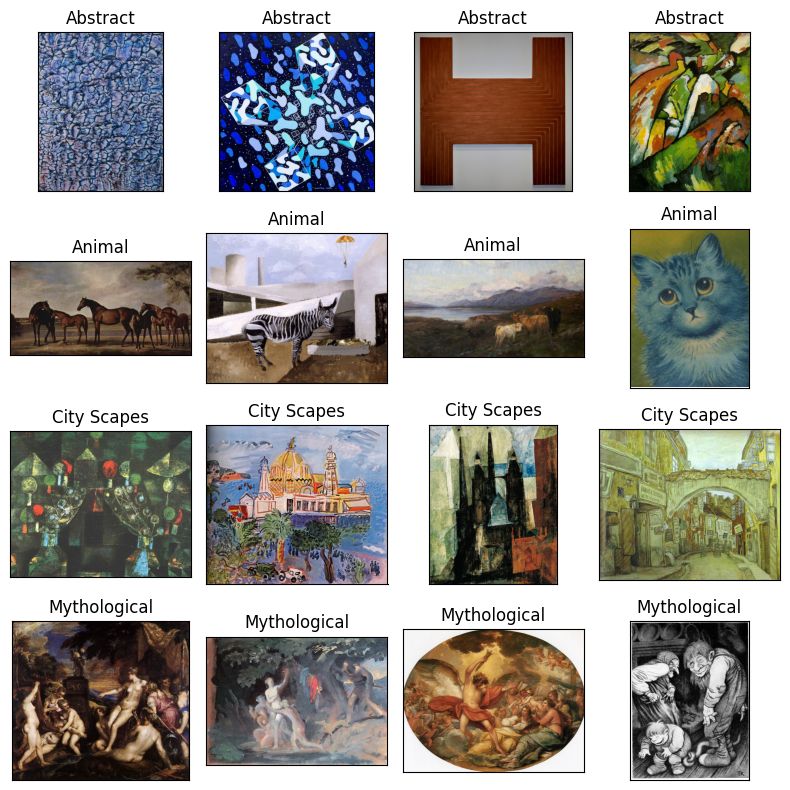

In [78]:
plot_images(images, categories, 4, 4, step=25)

The UMAP embedding of the gram matrices of the 400 samples from 4 different classes. It is worth noting the deeper the layer the less granulated the embedding is. This is because the deeper the layer the more abstract the features are. This results in classes being more separated in the deeper layer encodings.

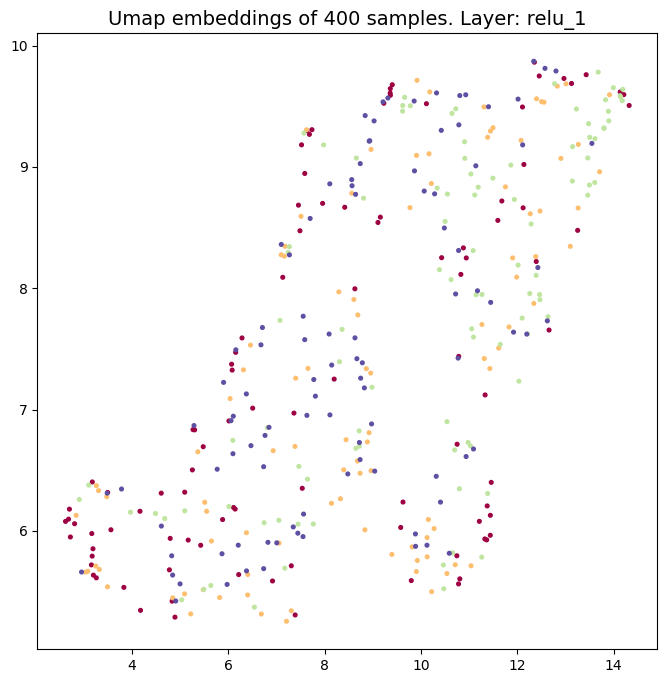

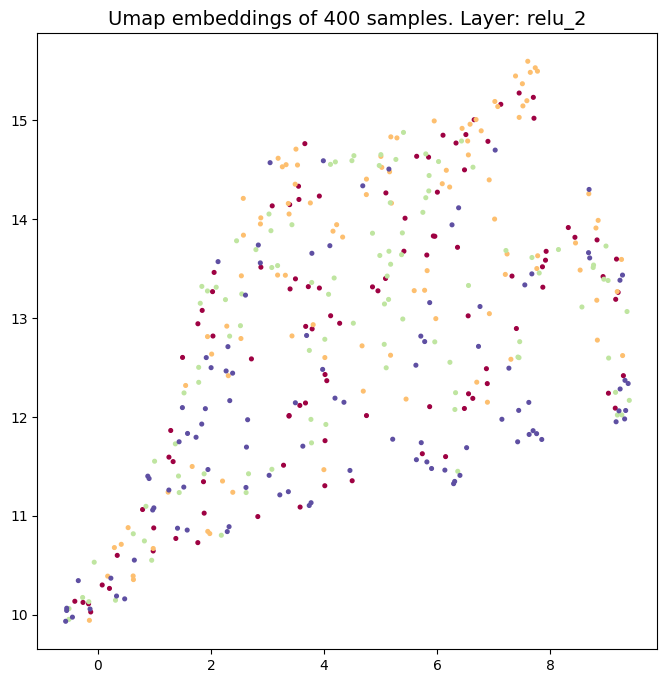

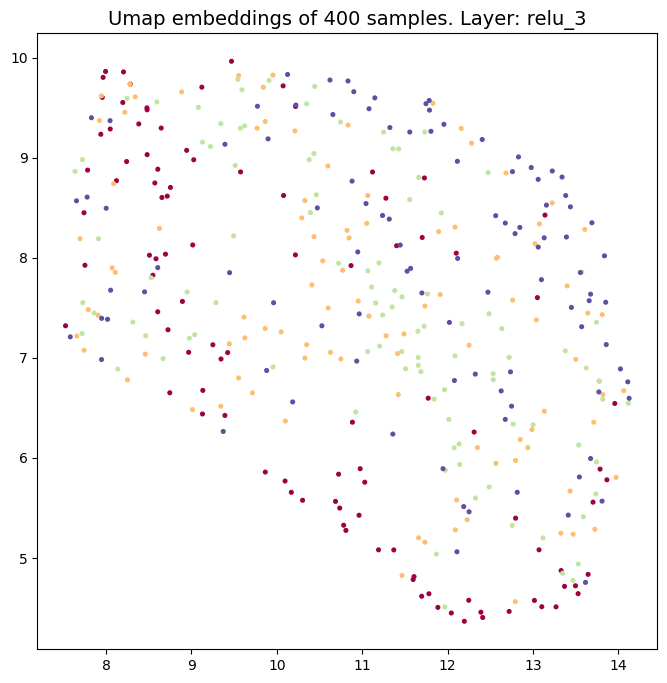

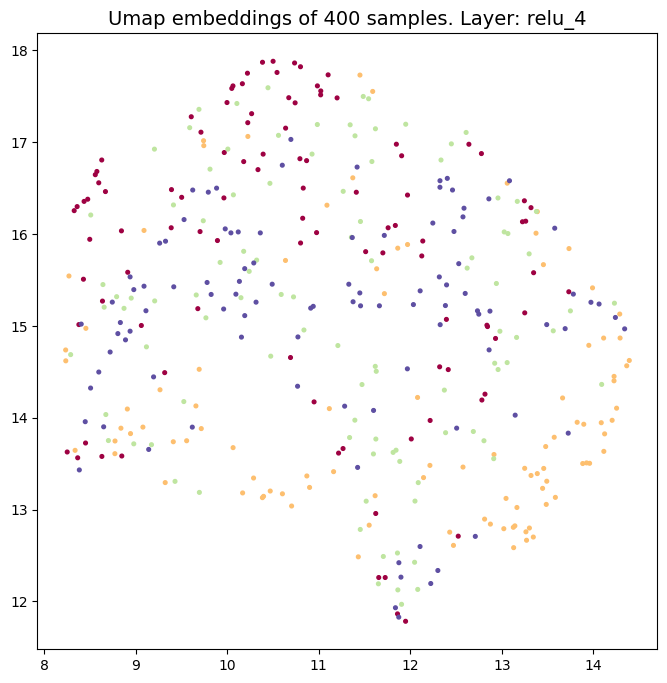

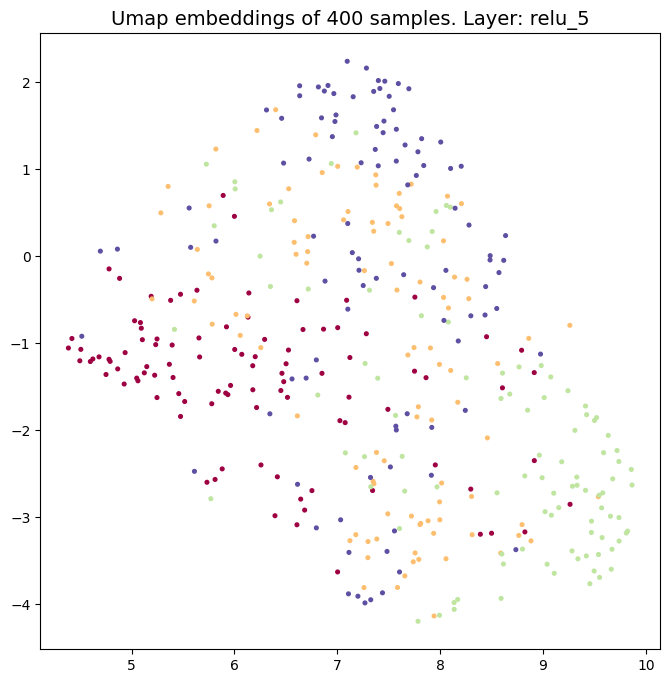

In [79]:
layers = ["relu_1", "relu_2", "relu_3", "relu_4", "relu_5"]
filepaths = [Path(f"sample_umap/{layer}_umap.npy") for layer in layers]
umap_embeddings = [np.load(filepath) for filepath in filepaths]

for i, umap_embedding in enumerate(umap_embeddings):
    draw_umap_with_labels(umap_embedding, labels, title=f'Umap embeddings of 400 samples. Layer: relu_{str(i + 1)}')


For a better understanding of the embedding we look at the aforementioned 16 samples from 4 classes. We can see that i.e. for layer relu3_1 the colorful depiction of a city is close to more vibrant of the abstract painting. The viewer can decide if the following layers are able to capture the style of the painting. 

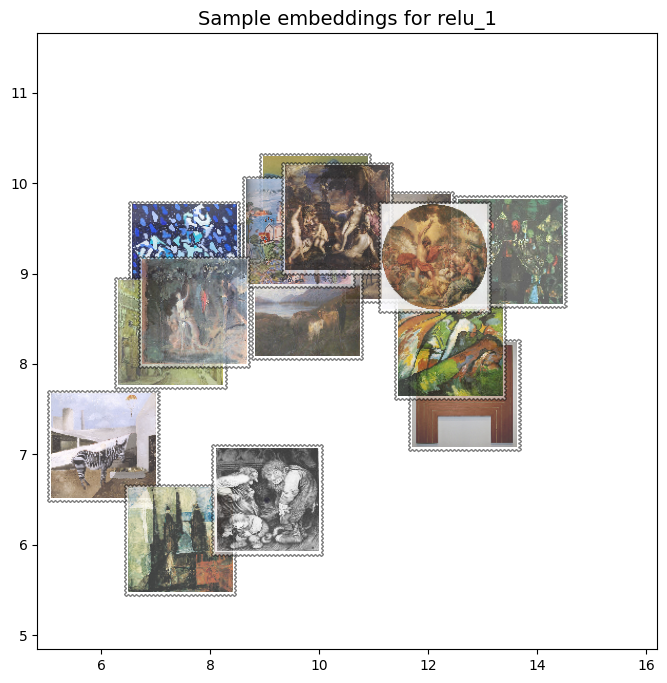

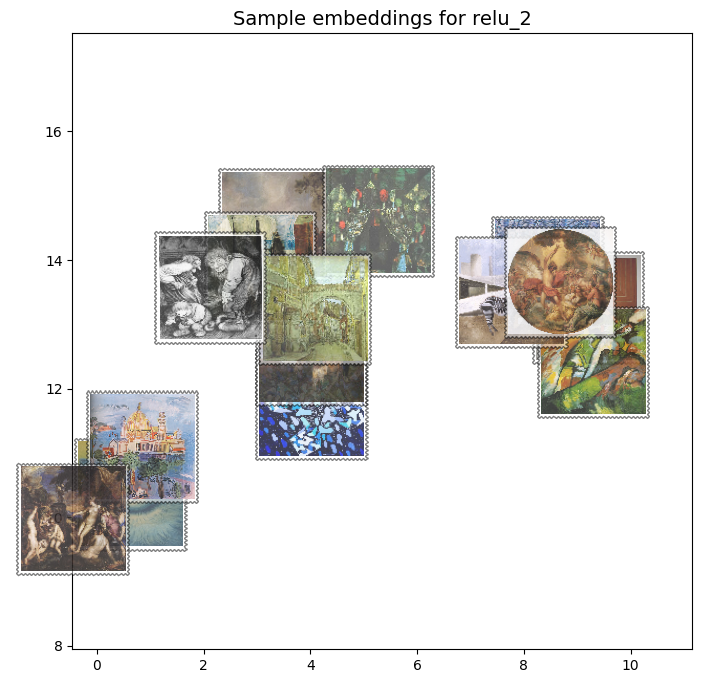

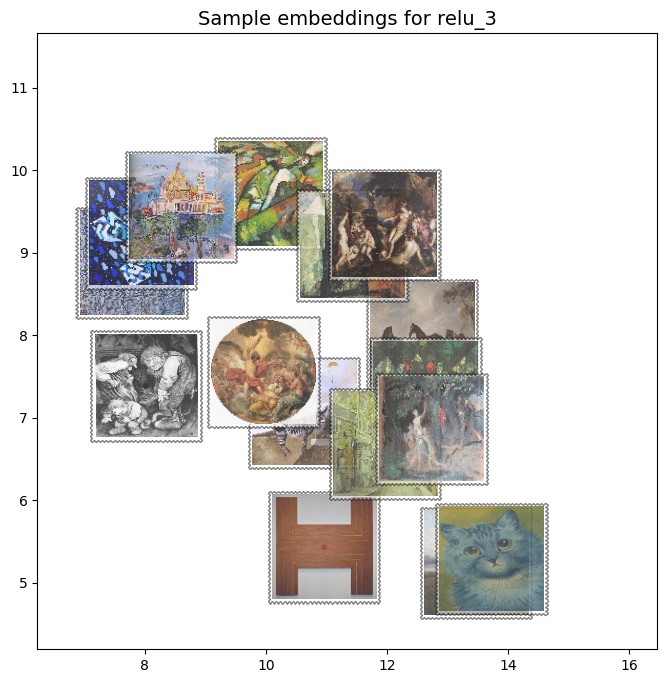

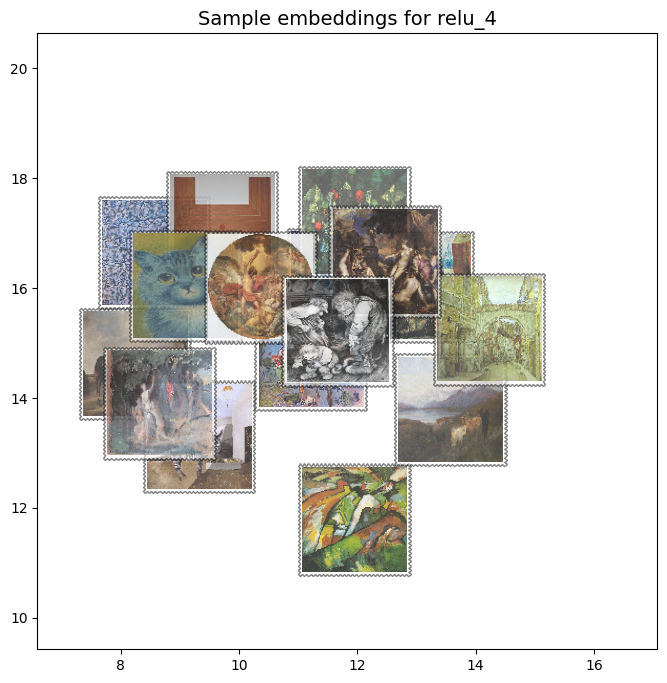

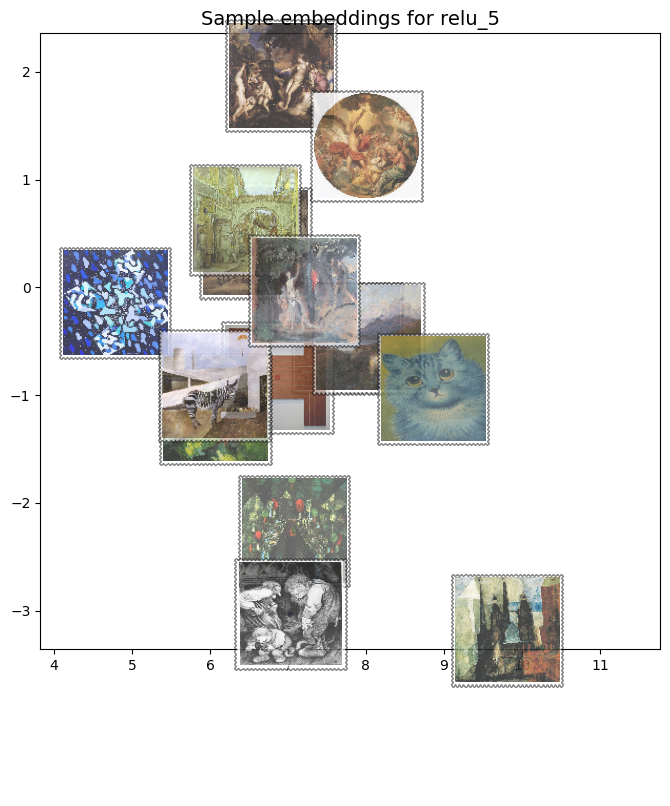

In [80]:
sample_image_paths = [image_path for image_path in image_filepaths[::25]]
sample_labels = [label for label in labels[::25]]

sample_umap_embeddings = [umap_embedding[::25, :] for umap_embedding in umap_embeddings]

for i, umap_embedding in enumerate(sample_umap_embeddings):
    draw_with_pictures(umap_embedding, sample_labels, sample_image_paths, title='Sample embeddings for relu_' + str(i + 1))

### Finding similar paintings with KDTree

We concatenate the 5 vectors of length 2 to a single vector of length 10. This vector is then used for a KDTree search. The KDTree search is used to find the 5 most similar paintings. The results are shown below.

In [81]:
concatenated_umap_embeddings = np.concatenate(umap_embeddings, axis=1)
tree = KDTree(concatenated_umap_embeddings)
distances, indices = tree.query(concatenated_umap_embeddings, k=10)

print(indices)


[[  0  17 190 ... 108   2  37]
 [  1 179 202 ...  78 279 218]
 [  2  18  13 ...  37  68  61]
 ...
 [397 131 237 ... 154  68 206]
 [398 251 111 ... 216 236 196]
 [399 329 372 ... 167 333 347]]


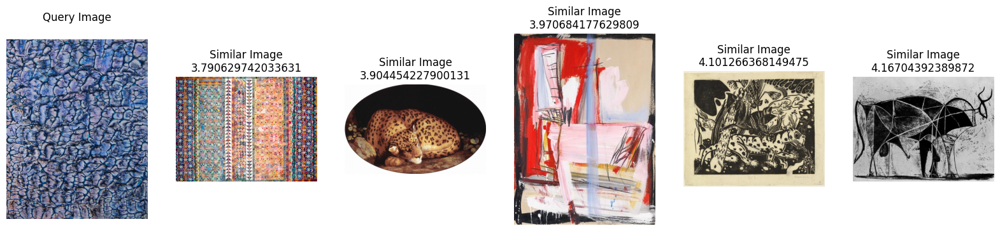

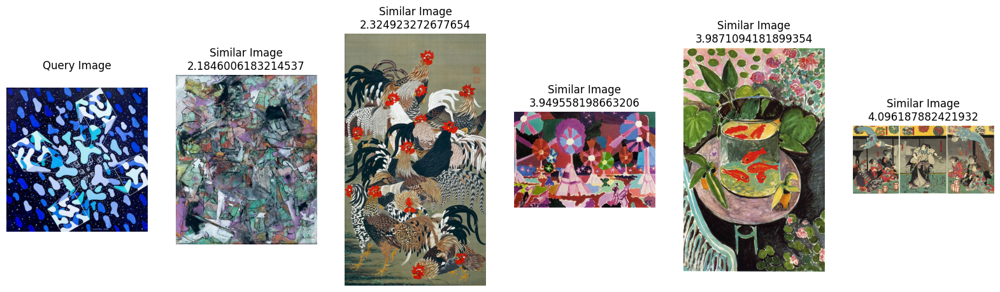

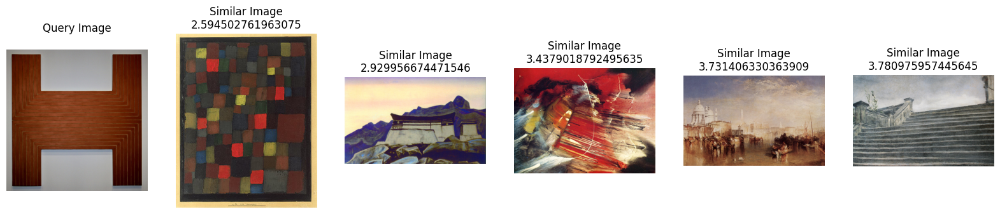

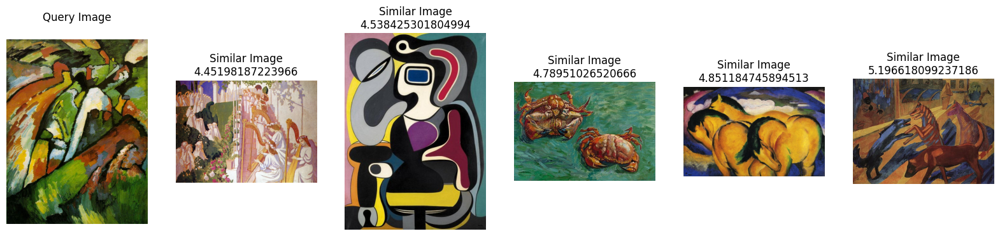

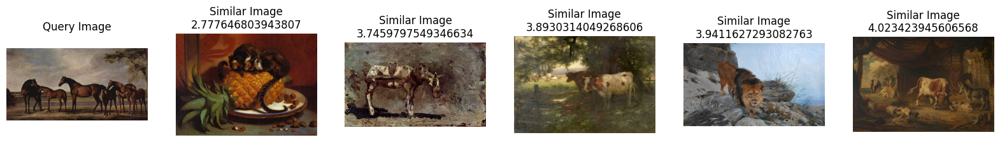

...

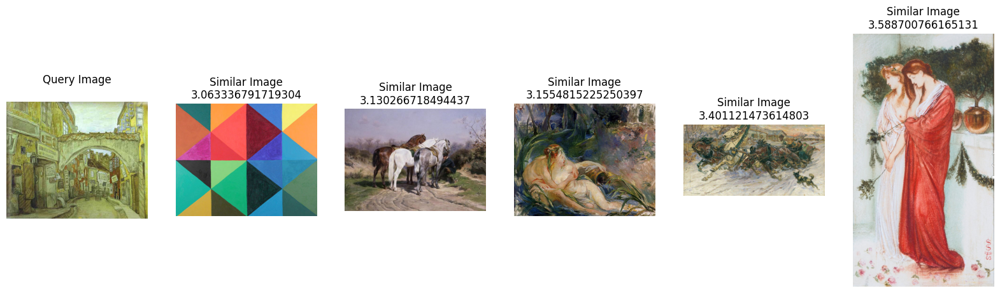

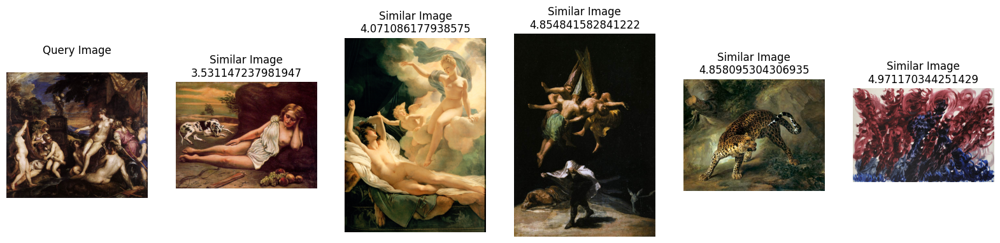

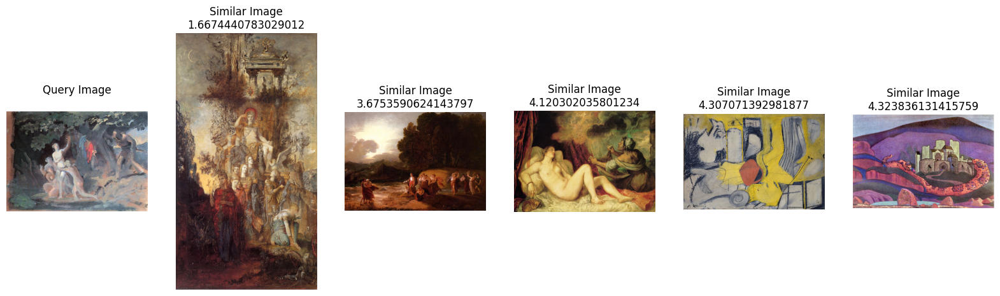

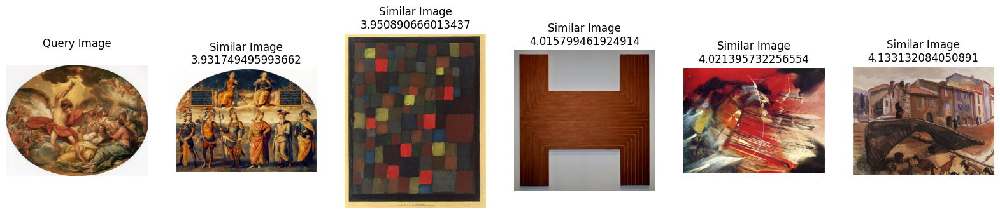

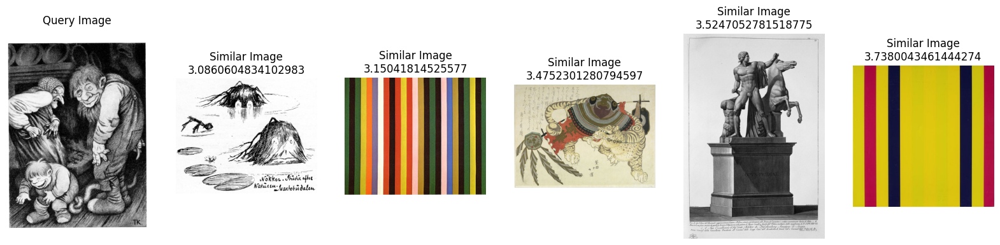

In [130]:
def plot_similar_images(query_image, distances, indices):
    plt.figure(figsize=(20, 20))
    plt.subplot(1, 6, 1)
    plt.imshow(query_image)
    plt.title("Query Image\n")
    plt.axis('off');

    for i in range(1, 6):
        plt.subplot(1, 6, i+1)
        plt.imshow(images[indices[i]])
        plt.title("Similar Image\n" + str(distances[i]))
        plt.axis('off');

    plt.show()

for i in range(0, 400, 25):
    plot_similar_images(images[i], distances[i], indices[i])

In [83]:
import csv

def write_to_csv(hashtags, categories, closest_neighbors, output_file):
    with open(output_file, 'w', newline='') as file:
        writer = csv.writer(file, delimiter=',')
        writer.writerow(['Hashtag', 'Category'] + [f'Similar_{i}' for i in range(1, 11)])
        for hashtag, category, neighbors in zip(hashtags, categories, closest_neighbors):
            writer.writerow([hashtag, category] + neighbors)

def find_closest_neighbors_hashtags(indices, k):
    return [ [image_hashes[idx] for idx in indices[i, 1:k+1]] for i in range(len(indices))]

for hashes, category, neighbors in zip(image_hashes, categories, find_closest_neighbors_hashtags(indices, 10)):
    print(f"{hashes} {category} {neighbors}")

write_to_csv(image_hashes, categories, find_closest_neighbors_hashtags(indices, 10), "sample_umap/umap_neighbors.csv")

5dce8d4c2c9685c684e4ffa66010adf3 Abstract ['d8c65c8d1b8c2ce191943f2d7e866b95', '0e282a619460342b454b176dcb57d6d2c', '465ea17ceedc4818a233a67d72480545', '1b8d8bddbfbd7b756bbfc01c1c6e9f43c', '03b9985c0cf55bbb714c320fef5bd093c', '29f39667742bbb655df29823814b7733', 'eef69290a7f0dac541f3244748a3caa2c', 'b94b00e703aa6e44558de605cbc4bf0d', '0db6a7ac5080d7d6d245a1678c43c564']
a6aebb3d101e481b3802da305da31216 Abstract ['2a569665b138c727028d11106db89334c', '88ef8c0d62ce30debb270e48248c65fbc', 'ee3d30ce09a3ffbe4c4c89d6e81ff00fc', 'dfff8c0ffc4ed9d9dbb5d55e574c3272c', '361b6f34f60fc2e195c96dea1142a5dcc', 'da121865725229dbce952473096fa9d9', '051065221333e75359580527d7b2c12a', '3c193429d7602ce0a1270dc9a2101c38c', '513b57ad1865c2f5e2581cae00795fe8c']
b94b00e703aa6e44558de605cbc4bf0d Abstract ['29f39667742bbb655df29823814b7733', 'b29f09453fda25a21f76fb1ca0da6167', '80b4a901729de18c3f6537b43bd6d0ef', '0d679b008da22c800199f4408253c4f8', '465ea17ceedc4818a233a67d72480545', '63fa89cdb9f326e607b7fdcb556bfe2

### Conclusion

The proposed system seems good enough for the purpose of this project. The created pipeline is able to find similar paintings in a abstract way with only the data from the image itself. We will enhance it with more information from the color features in the next section.

## The same but for the entire dataset


In [84]:
# EMBED_PATH = Path("/media/pawel/DATA/iwisum/results/umap_embeddings")

# def get_all_layer_umap_embeddings(layer: str) -> np.array:
#     embedding_paths = list(EMBED_PATH.rglob(f"**/*{layer}*.npy"))
#     embedding_arrays = [np.load(path) for path in embedding_paths]
#     return np.concatenate(embedding_arrays, axis=0)

# layers = ["relu1", "relu2", "relu3", "relu4"]
# embeddings = [get_all_layer_umap_embeddings(layer) for layer in layers]
# img2vec = np.concatenate(embeddings, axis=1)


In [85]:
# def read_file(filepath):
#     with open(filepath, "r") as file:
#         lines =  [line.strip() for line in file.readlines()]
#     return lines

# def get_listing():
#     list_of_listing_filenames = sorted(list(LABELS_PATH.rglob("*.txt")))
#     return [IMAGES_PATH / Path(art_filename) for listing_filename in list_of_listing_filenames for art_filename in read_file(listing_filename)]

# listing = get_listing()
# print(listing[:10])

In [86]:
# tree = KDTree(img2vec)
# distances, indices = tree.query(img2vec, k=5)

# print(indices)


In [87]:
# def plot_similar_images(query_path, distances, indices):
#     plt.figure(figsize=(20, 20))
#     plt.subplot(1, 6, 1)
#     plt.imshow(Image.open(query_path))
#     plt.title("Query Image\n")
#     plt.axis('off');

#     for i in range(5):
#         plt.subplot(1, 6, i+2)
#         plt.imshow(Image.open(listing[indices[i]]))
#         plt.title("Similar Image\n" + str(distances[i]))
#         plt.axis('off');

#     plt.show()

# for i in range(0, 400, 25):
#     plot_similar_images(listing[i], distances[i], indices[i])

## Color mapping

### Functions needed


In [100]:

def load_and_preprocess_image(image_path):
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    image = cv2.resize(image, (256, 256))
    return image

def random_sample_pixels(image, sample_size=625, seed=42):
    height, width, _ = image.shape
    np.random.seed(seed)
    indices = np.random.choice(height * width, size=sample_size, replace=False)
    sampled_pixels = np.array([image[idx // width, idx % width] for idx in indices])
    return sampled_pixels

def count_pixels_per_color_region(sampled_pixels, colorspace_divisions=4): #8):
    color_counts = np.zeros((colorspace_divisions, colorspace_divisions, colorspace_divisions))
    bins = np.linspace(0, 256, colorspace_divisions)
    
    for pixel in sampled_pixels:
        r, g, b = pixel.astype(int)
        
        color_counts[np.digitize(r, bins),
                     np.digitize(g, bins),
                     np.digitize(b, bins)] += 1

    return color_counts.flatten()

def image_to_color_code(image_path, sample_size=625, colorspace_divisions=4, seed=42): #8):
    image = load_and_preprocess_image(image_path)
    sampled_pixels = random_sample_pixels(image, sample_size, seed=seed)
    return count_pixels_per_color_region(sampled_pixels, colorspace_divisions)





### Performing color mapping


In [101]:
color_mapping = [image_to_color_code(image_path.as_posix()) for image_path in image_filepaths]

print(color_mapping[0])

[  0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0. 108. 112.   0.   0.   0.  42.   8.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   1.   0.   0.   0.
 157. 124.   0.   0.   0.  36.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   4.   0.   0.   1.  32.]



### Visualizing


In [106]:
from umap import UMAP
from sklearn.preprocessing import normalize

umap_color_reducer = UMAP(n_components=3, metric='cosine', random_state=42)

umap_color_embeddings = umap_color_reducer.fit_transform(normalize(color_mapping)) 

/home/pawel/Documents/studia/sem9/IWISUM/artsygest/venv/lib/python3.11/site-packages/umap/umap_.py:1943: UserWarning: n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


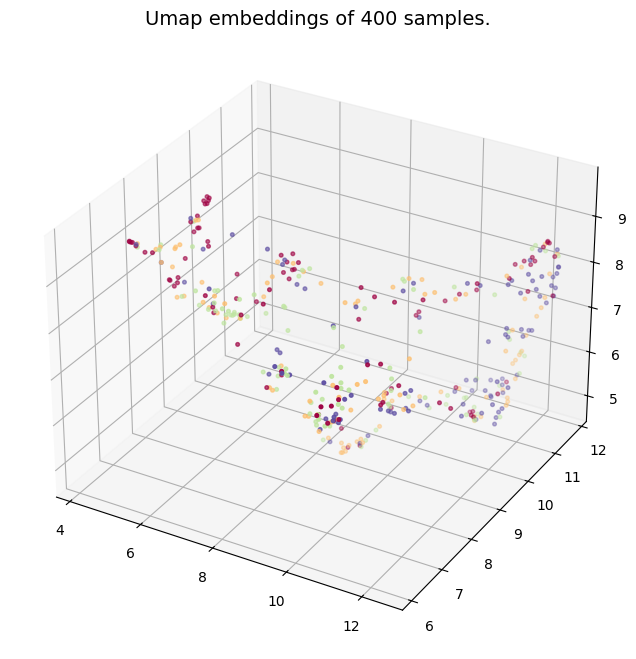

In [107]:
def draw_umap_with_labels(umap_embeddings, labels, title=''):
    fig = plt.figure(figsize=(8, 8))
    ax = fig.add_subplot(111, projection='3d')
    
    ax.scatter(umap_embeddings[:, 0], umap_embeddings[:, 1], umap_embeddings[:, 2], c=labels, s=7, cmap='Spectral',)
    ax.set_title(title, fontsize=14)
    # plt.savefig(title + '.png')
    plt.show()
    
draw_umap_with_labels(umap_color_embeddings, labels, title='Umap embeddings of 400 samples.')

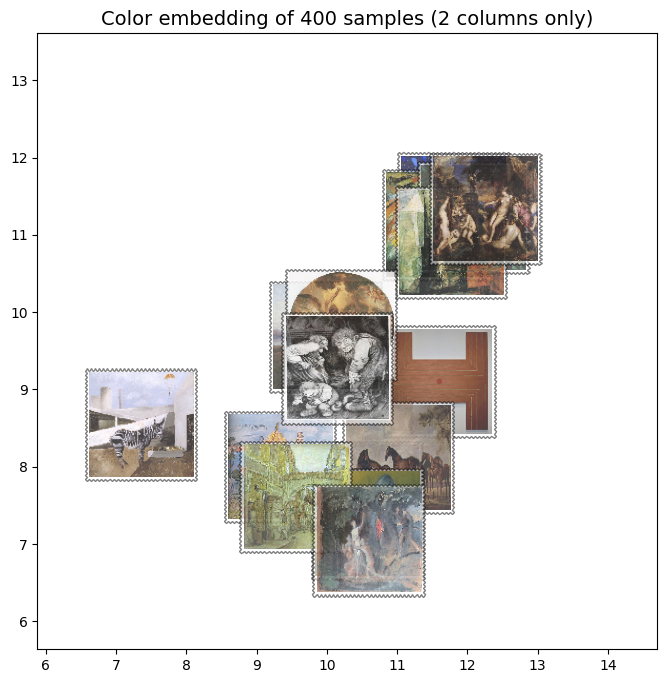

In [108]:
sample_color_umap_embeddings = umap_color_embeddings[::25, :]


draw_with_pictures(sample_color_umap_embeddings, 
                   sample_labels, 
                   sample_image_paths,
                   title='Color embedding of 400 samples (2 columns only)')


### Similarity

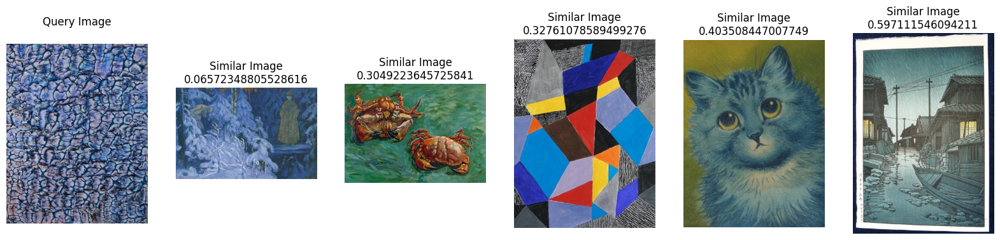

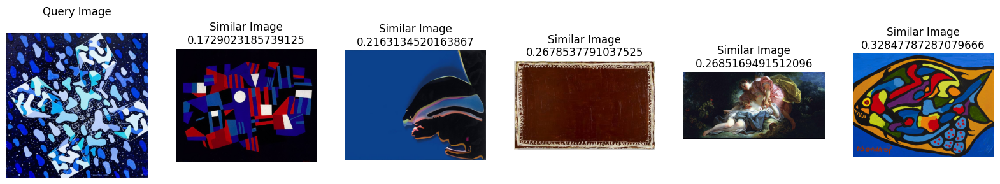

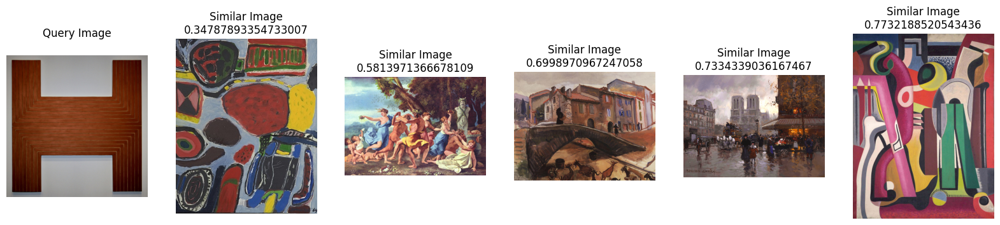

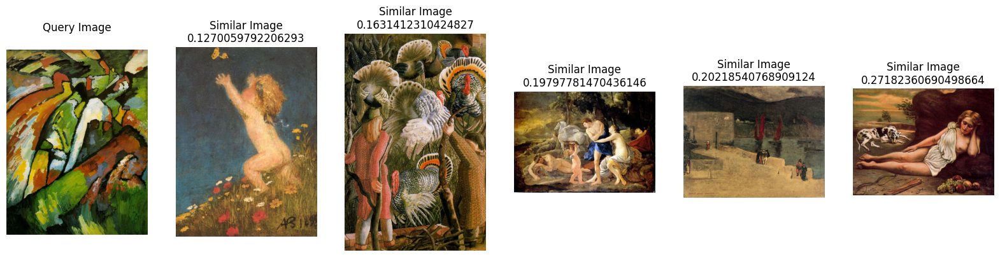

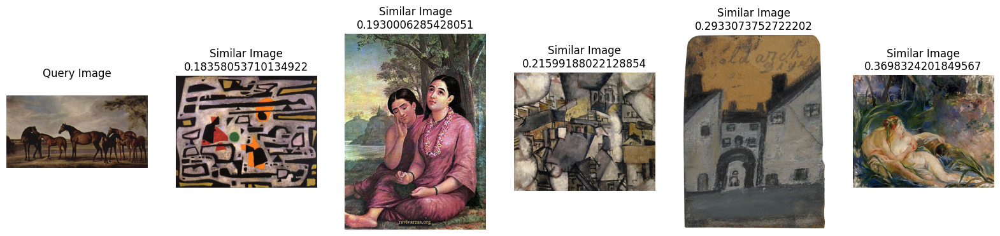

...

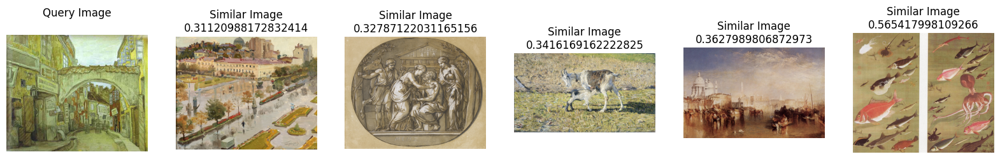

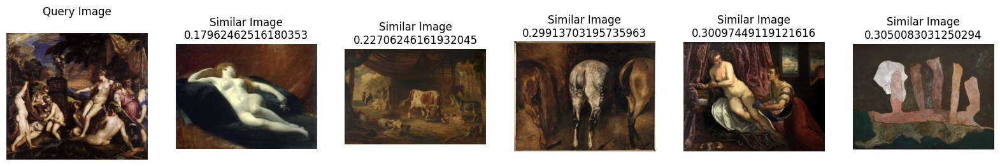

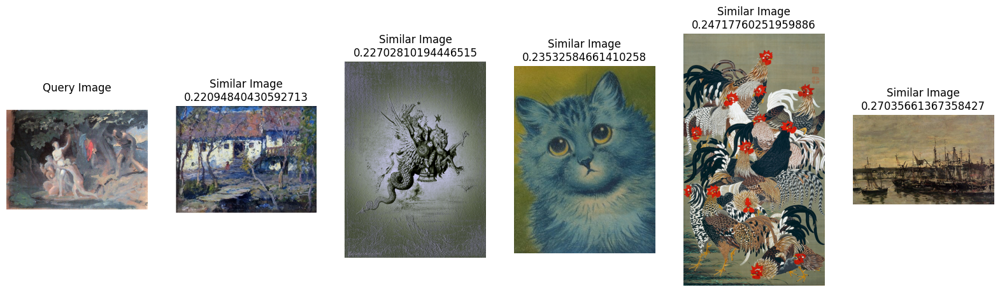

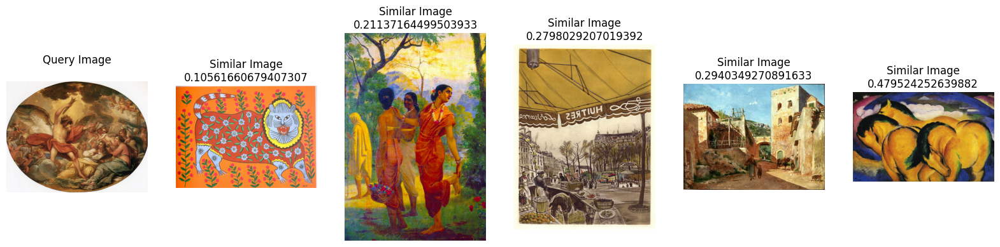

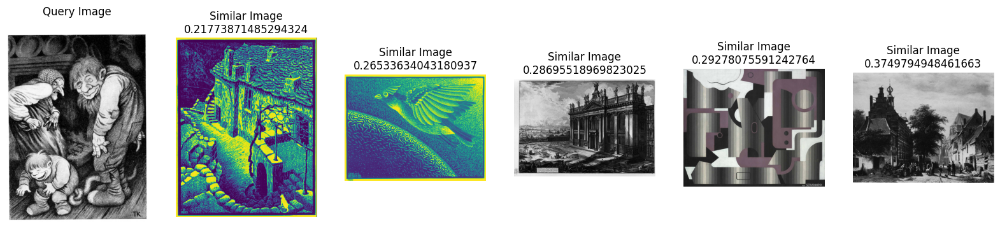

In [131]:
color_tree = KDTree(umap_color_embeddings)
distances_color, indices_color = color_tree.query(umap_color_embeddings, k=10)

for i in range(0, 400, 25):
    plot_similar_images(images[i], distances_color[i], indices_color[i])

## Putting it all together

### Concatenation


In [123]:
final_umap_embedding = np.concatenate([concatenated_umap_embeddings, umap_color_embeddings], axis=1)
final_umap_embedding.shape

(400, 13)

In [133]:
def standardize_embeddings(embeddings):
    min_embedding = embeddings.min(axis=0)
    max_embedding = embeddings.max(axis=0)
    return (embeddings - min_embedding) / (max_embedding - min_embedding)

final_umap_embedding = standardize_embeddings(final_umap_embedding)

mean_per_column = final_umap_embedding.mean(axis=0)
std_per_column = final_umap_embedding.std(axis=0)


In [134]:
print("Mean per column")
print(mean_per_column)

Mean per column
[0.5384091  0.48499832 0.52078795 0.5091781  0.5341446  0.5583365
 0.48809528 0.5353157  0.5391453  0.46867535 0.62866664 0.49797443
 0.5282422 ]


In [135]:
print("Std per column")
print(std_per_column)

Std per column
[0.25483504 0.3090996  0.26928148 0.24461544 0.2839733  0.2613145
 0.27433673 0.24201491 0.23907723 0.2518563  0.28283566 0.27293718
 0.2518711 ]



### Similarity

In [136]:
final_tree = KDTree(final_umap_embedding)
final_distances, final_indices = final_tree.query(final_umap_embedding, k=10)

Final results


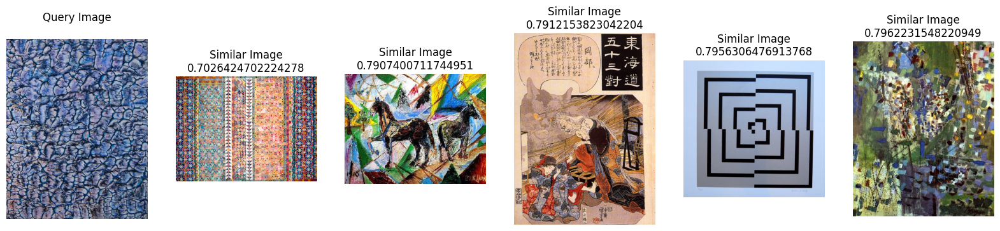

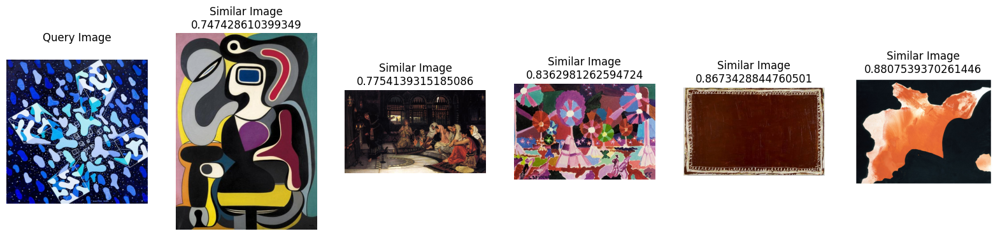

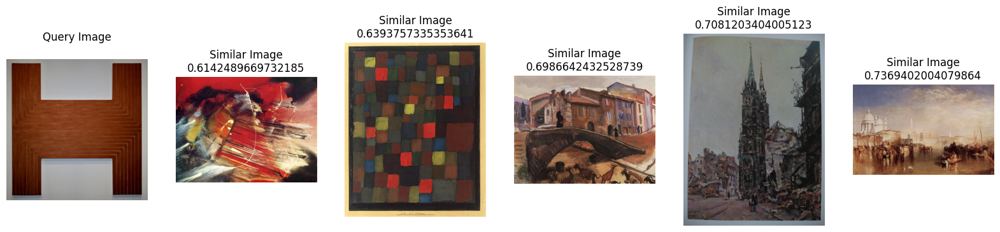

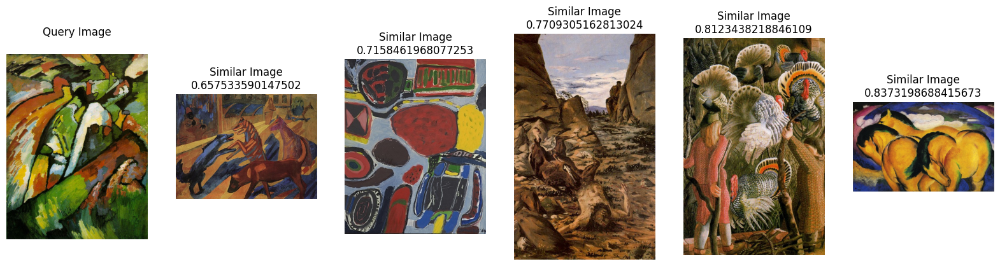

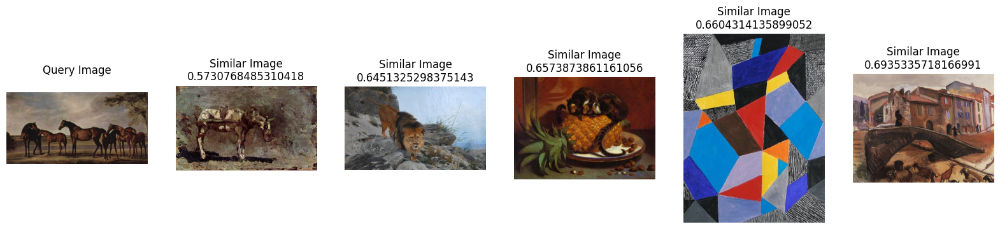

...

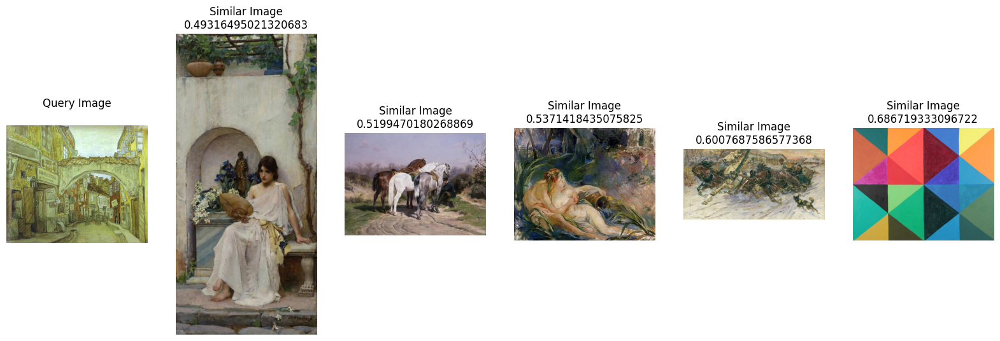

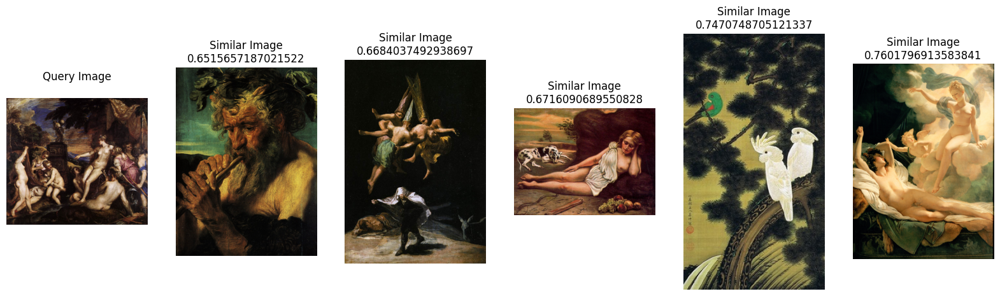

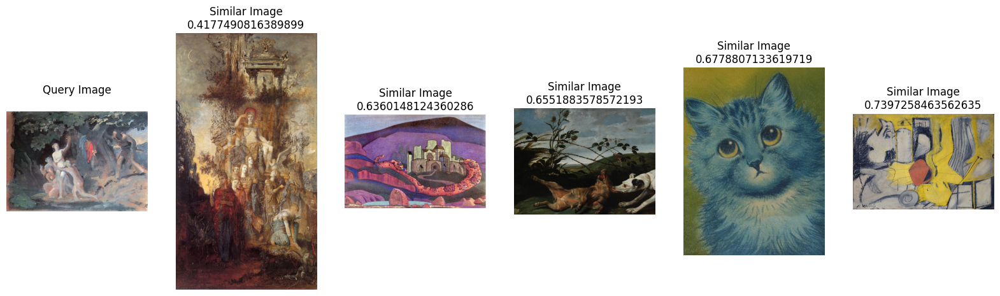

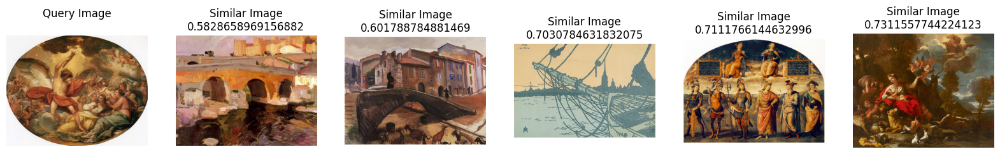

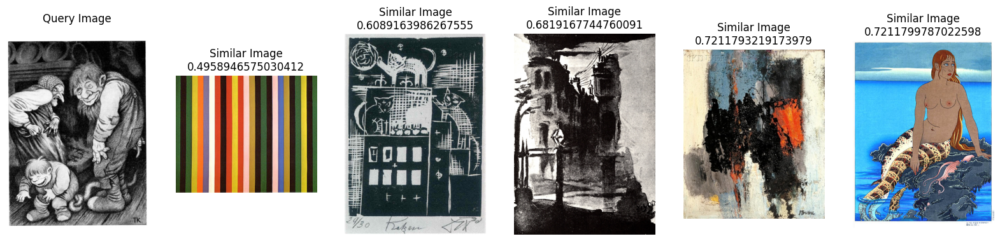

In [137]:
print("Final results")
for i in range(0, 400, 25):
    plot_similar_images(images[i], final_distances[i], final_indices[i])